In [1]:
import pickle
import random
import time
from datetime import datetime, timedelta
import random

import numpy as np
import pandas as pd
import dask.dataframe as dd
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive
import folium

# Mount Google Drive (specific to Google Colab)
drive.mount('/content/drive')


/usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
Dask dataframe query planning is disabled because dask-expr is not installed.

You can install it with `pip install dask[dataframe]` or `conda install dask`.
This will raise in a future version.

  warnings.warn(msg, FutureWarning)


Mounted at /content/drive


In [ ]:
trajFile = '/content/drive/MyDrive/synMob-losAngeles/trajectories.parquet'

# Read the parquet file using Dask
ddf = dd.read_parquet(trajFile)

# Convert to Dask DataFrame to Pandas, group by 'uuid', and convert
trajectory_list = (
    ddf.groupby('uuid')
    .apply(lambda x: x[['longitude', 'latitude']].to_numpy(), meta=('x', 'object'))
    .compute(scheduler='threads')  # Use threading to avoid GIL limitation
    .tolist()
)

# Save the list to a pickle file
pd.to_pickle(trajectory_list, 'trajectories.pkl')

In [ ]:


def timestamp_to_interval(timestamp):
    # Convert Unix timestamp to datetime
    dt = datetime.utcfromtimestamp(timestamp)

    # Calculate the 5-minute interval of the day
    minutes_since_midnight = dt.hour * 60 + dt.minute
    interval = minutes_since_midnight // 5

    return interval

def convert_parquet_to_pkl(input_path, output_path):
    # Load the data from a Parquet file
    df = pd.read_parquet(input_path)

    # Convert 'departure_time' from Unix timestamp to 5-minute interval
    df['departure_time'] = df['departure_time'].apply(timestamp_to_interval)

    # Subtract 1 from 'count'
    df['count'] = df['count'] + 1

    # Selecting the required columns
    df_processed = df[['travel_distance', 'travel_time', 'departure_time', 'count']]

    # Convert the DataFrame to a NumPy array
    np_array = df_processed.to_numpy().tolist()

    # Save the numpy array to a pickle file
    pd.to_pickle(np_array, output_path)

    print(f"File has been converted and saved to {output_path}")


input_parquet_path = '/content/drive/MyDrive/losAngeles/trajectory_meta.parquet'  # Specify your input file path
output_pickle_path = 'trajectory_meta.pkl'    # Specify your output file path

convert_parquet_to_pkl(input_parquet_path, output_pickle_path)

In [3]:
metadata_path = '/content/drive/MyDrive/synMob-losAngeles/convertedPickleFiles/trajectory_meta.pkl'
trajectories_path = '/content/drive/MyDrive/synMob-losAngeles/convertedPickleFiles/trajectories.pkl'

# Load data
with open(metadata_path, 'rb') as file:
    metadata = pickle.load(file)
with open(trajectories_path, 'rb') as file:
    trajectories = pickle.load(file)

metadata = np.array(metadata)

print(f'Loaded {len(metadata)} synthetic trajectories.')
print(f'Metadata dimensions: {metadata.shape}')
print(f'Trajectories count: {len(trajectories)}')

Loaded 1500000 synthetic trajectories.
Metadata dimensions: (1500000, 4)
Trajectories count: 1500000


In [4]:
!pip install geopy

In [5]:
from geopy.distance import geodesic
import multiprocessing as mp

def calculate_distance(traj):
    dists = [geodesic(traj[i][::-1], traj[i+1][::-1]).meters for i in range(len(traj)-1)]
    return sum(dists)

def parallel_distance_computation(trajectories, processors=8):
    with mp.Pool(processors) as pool:
        distances = pool.map(calculate_distance, trajectories)
    return distances

In [ ]:
sample_indices = random.sample(range(len(trajectories)), 100000)
sampled_trajectories = [trajectories[i] for i in sample_indices]
sampled_metadata = np.array([metadata[i] for i in sample_indices])

start = time.time()
computed_distances = parallel_distance_computation(sampled_trajectories, processors=20)
elapsed = time.time() - start
print(f"Distance computation completed in {elapsed:.3f} seconds.")

# Calculate lengths
trajectory_lengths = np.array([len(traj) for traj in sampled_trajectories])

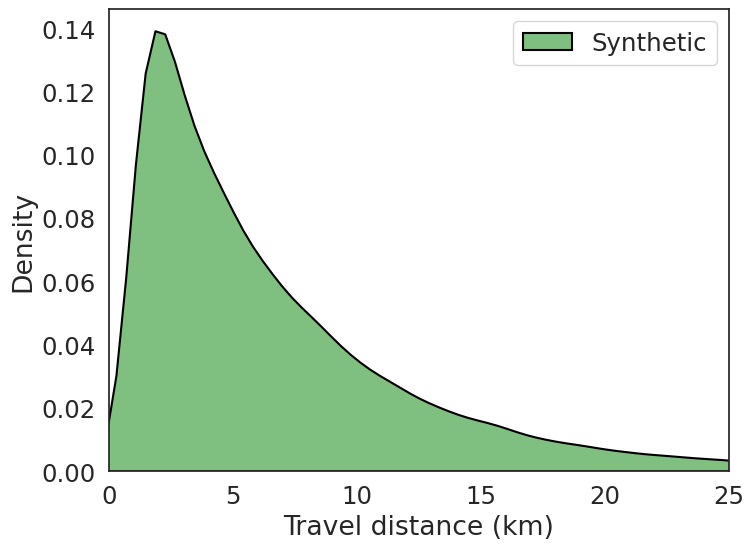

In [ ]:
# draw the distance distribution
trip_distance = np.array(computed_distances)
plt.figure(figsize=(8, 6))
sns.color_palette("Paired")
sns.set(font_scale = 1.6)
sns.set_style("white")
sns.kdeplot(trip_distance / 1000, fill=True, edgecolor='black', color="green", alpha=0.5, lw= 1.5,label='Synthetic')
# set the x-axis limit
plt.xlim(0, 25)
plt.legend(loc='upper right')
plt.xlabel('Travel distance (km)')
plt.ylabel('Density')
plt.show()

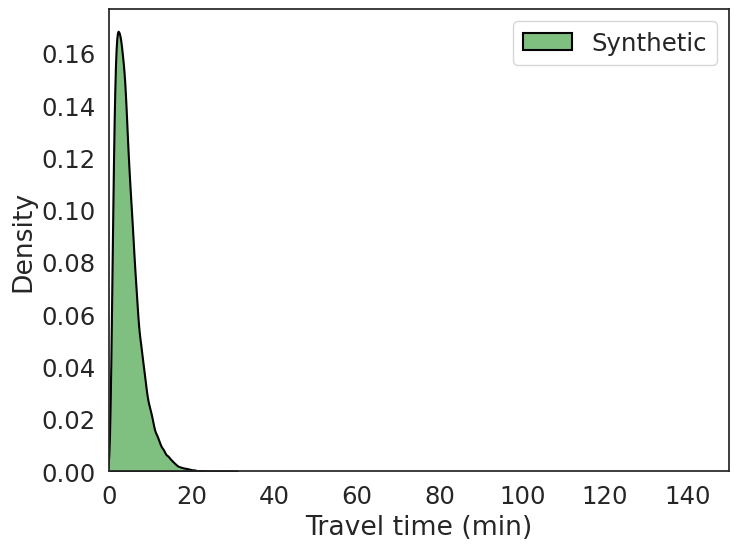

In [ ]:
trip_time = trajectory_lengths*3
plt.figure(figsize=(8, 6))
sns.color_palette("Paired")
sns.set(font_scale = 1.6)
sns.set_style("white")
sns.kdeplot(trip_time / 60, fill=True, edgecolor='black', color="green", alpha=0.5, lw= 1.5,label='Synthetic')
plt.xlim(0, 150)
plt.legend(loc='upper right')
plt.xlabel('Travel time (min)')
plt.ylabel('Density')
plt.show()

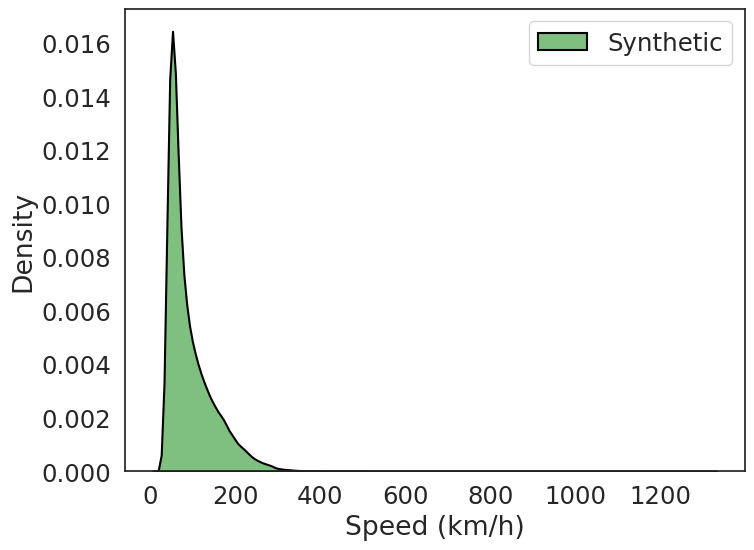

In [ ]:
trip_speed = np.array([x / y *3.6 for x, y in zip(trip_distance, trip_time)])
plt.figure(figsize=(8, 6))
sns.color_palette("Paired")
sns.set(font_scale = 1.6)
sns.set_style("white")
sns.kdeplot(trip_speed, fill=True, edgecolor='black', color="green", alpha=0.5, lw= 1.5,label='Synthetic')
plt.legend(loc='upper right')
plt.xlabel('Speed (km/h)')
plt.ylabel('Density')
plt.show()

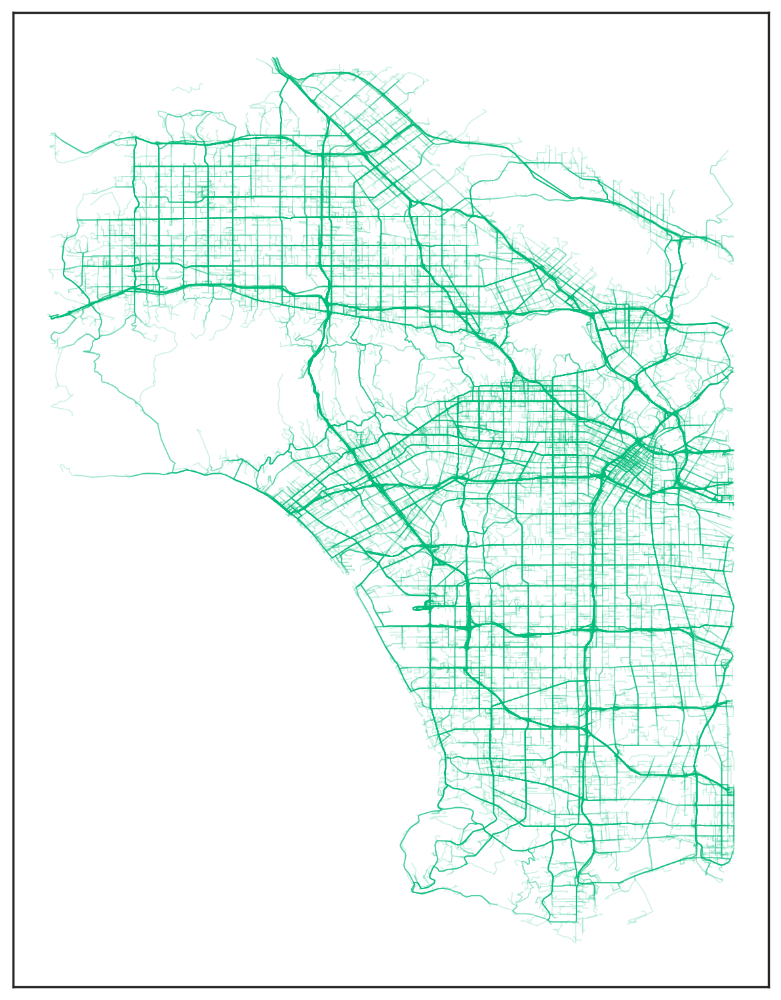

In [ ]:
trajs_list = trajectories[:10000]
fig, ax = plt.subplots(1, 1, dpi=200, figsize=(8, 8))
plt.subplots_adjust(top=0.98, bottom=0.02, left=0.05, right=0.95, hspace=0.02,wspace=0.05)

ax.set_aspect('equal')
ax.axes.xaxis.set_ticklabels([])
ax.axes.yaxis.set_ticklabels([])
for j, trip in enumerate(trajs_list):
    ax.plot(trip[:, 0], trip[:, 1], color = (0.00392, 0.74118, 0.47451), linewidth=0.6, alpha=0.2)

plt.tight_layout()
plt.show()

In [ ]:
def divide_grids(boundary, grids_num):
    lati_min, long_min = boundary['lati_min'], boundary['long_min']
    lati_max, long_max = boundary['lati_max'], boundary['long_max']
    lati_interval = (lati_max - lati_min) / grids_num
    long_interval = (long_max - long_min) / grids_num
    latgrids = np.arange(lati_min, lati_max, lati_interval)
    longrids = np.arange(long_min, long_max, long_interval)
    return latgrids, longrids


# count the number of points in each grid
def count_points_in_grid(lng, lati, longrids, latgrids):
    lati_index = np.where(lati > latgrids)[0][-1]
    long_index = np.where(lng > longrids)[0][-1]
    return lati_index, long_index

In [ ]:
!pip install folium

In [ ]:
# Initialize lists to store all longitudes and latitudes
all_longitudes = []
all_latitudes = []

# Loop through all trajectories
for traj in trajectories:
    all_longitudes.extend(traj[:, 0])
    all_latitudes.extend(traj[:, 1])

# Convert lists to numpy arrays for easier manipulation
all_longitudes = np.array(all_longitudes)
all_latitudes = np.array(all_latitudes)

# Calculate the average longitude and latitude
average_longitude = np.mean(all_longitudes)
average_latitude = np.mean(all_latitudes)

print(f"Average Longitude: {average_longitude}")
print(f"Average Latitude: {average_latitude}")


Average Longitude: -118.36237412222094
Average Latitude: 34.051405333903034


In [ ]:


# Use the averages calculated previously to initialize the map
m = folium.Map(location=[average_latitude, average_longitude], zoom_start=12)

sampled_trajs = random.sample(trajectories, 4000)
# Add trajectories to the map
for traj in sampled_trajs:
    # Swap the coordinates because Folium expects them in [latitude, longitude] format
    folium_route = [(lat, lon) for lon, lat in traj]
    folium.PolyLine(locations=folium_route, weight=1, color='blue').add_to(m)

# display the map
m


In [ ]:
import dask.dataframe as dd
import pandas as pd
import numpy as np
import random
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Embedding
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.callbacks import EarlyStopping
import folium
import pickle


In [ ]:
traj_path = '/content/drive/MyDrive/synMob-losAngeles/convertedPickleFiles/trajectories.pkl'
meta_path = '/content/drive/MyDrive/synMob-losAngeles/convertedPickleFiles/trajectory_meta.pkl'

with open(traj_path, 'rb') as f:
    trajs = pickle.load(f)

with open(meta_path, 'rb') as f:
    attrs = pickle.load(f)

print(f"Loaded {len(trajs)} trajectories.")


Loaded 1500000 trajectories.


In [ ]:
# Define the boundaries and resolution
boundary = {
    'lati_min': np.min([point[1] for traj in trajectories for point in traj]),
    'lati_max': np.max([point[1] for traj in trajectories for point in traj]),
    'long_min': np.min([point[0] for traj in trajectories for point in traj]),
    'long_max': np.max([point[0] for traj in trajectories for point in traj])
}
grid_resolution = 0.02  # Adjust for coarser grids

# Function to encode latitude and longitude into grid indices
def encode_to_grid(lon, lat, boundary, grid_resolution):
    long_index = int((lon - boundary['long_min']) / grid_resolution)
    lati_index = int((lat - boundary['lati_min']) / grid_resolution)
    return long_index, lati_index

# Preprocess trajectories into grid sequences
grid_trajectories = []
for traj in trajectories:
    grid_trajectory = [encode_to_grid(lon, lat, boundary, grid_resolution) for lon, lat in traj]
    grid_trajectories.append(grid_trajectory)

print("Grid encoding complete.")


KeyboardInterrupt: 

###Prepare the Training Data

In [ ]:
inputs = []
outputs = []
sequence_length = 5  # Define how many past points are used for prediction

for traj in grid_trajectories:
    if len(traj) > sequence_length:
        for i in range(len(traj) - sequence_length):
            inputs.append(traj[i:i + sequence_length])  # Past sequence
            outputs.append(traj[i + sequence_length])  # Next point

# Downsample the data for faster training
sample_size = 50000  # Use 100,000 samples instead of the full dataset
sample_indices = random.sample(range(len(inputs)), sample_size)
X_sampled = [inputs[i] for i in sample_indices]
y_sampled = [outputs[i] for i in sample_indices]

# Flatten grid indices into a single integer for the model
X_flattened = [[x[0] * 1000 + x[1] for x in seq] for seq in X_sampled]
y_flattened = [y[0] * 1000 + y[1] for y in y_sampled]

# Pad sequences
max_seq_length = sequence_length
X = pad_sequences(X_flattened, maxlen=max_seq_length, padding='post')
y = np.array(y_flattened)


###Define the LSTM Model

In [ ]:
num_grid_cells = 1000000  # Based on grid encoding
model = Sequential([
    Embedding(input_dim=num_grid_cells, output_dim=32, input_length=max_seq_length),
    LSTM(32, return_sequences=False),
    Dense(num_grid_cells, activation='softmax')
])

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
print(model.summary())


NameError: name 'Sequential' is not defined

### congestion points



In [ ]:


# Assume this samples trajectories adequately
sampled_trajs = random.sample(trajectories, 60)  # Sample 1000 trajectories

def calculate_speed(traj):
    total_distance = 0
    total_time = 0
    if len(traj) > 1:
        for i in range(1, len(traj)):
            dist = distance((traj[i-1][1], traj[i-1][0]), (traj[i][1], traj[i][0])).meters
            total_distance += dist
            total_time += 1  # Assuming 1 minute intervals
        return total_distance / (total_time * 60)  # Speed in m/s
    return 0

speeds = [calculate_speed(traj) for traj in sampled_trajs]
print("Sample speeds:", speeds[:10])  # Debug: print sample speeds

congestion_threshold = 5  # m/s
congestion_points = [traj for traj, speed in zip(sampled_trajs, speeds) if speed < congestion_threshold]
print("Number of congested trajectories:", len(congestion_points))  # Debug: print the count of congested trajectories

# Assuming average latitude and longitude need recalculating
average_latitude = np.mean([point[1] for traj in sampled_trajs for point in traj])
average_longitude = np.mean([point[0] for traj in sampled_trajs for point in traj])

# Initialize map
m = folium.Map(location=[average_latitude, average_longitude], zoom_start=12)
for traj in congestion_points:
    folium_route = [(lat, lon) for lon, lat in traj]
    folium.PolyLine(locations=folium_route, weight=2, color='red').add_to(m)

# Display map in a Jupyter environment
m.save('congestion_map.html')
m  # This will display the map if you are using Jupyter Notebook/Lab


Sample speeds: [2.064920889035863, 1.137486724722539, 0.611265001457161, 0.8789648824900748, 0.5579246321492124, 1.3471361668436086, 0.7683096240821418, 0.771849506732979, 1.0035321052585346, 0.7932295032689978]
Number of congested trajectories: 60


In [ ]:
# Limit the number of trajectories to render for better performance
max_display_count = 1000

def simplify_trajectory(trajectory, max_points=100):
    """Simplify trajectory by keeping at most `max_points` evenly spaced."""
    step = max(1, len(trajectory) // max_points)
    return trajectory[::step]

def categorize_and_render_map(trajectories, map_center, zoom_start=12):
    """Categorize trajectories into long and short distances and render them on a map."""
    # Categorize trajectories into long and short distance
    long_distance = []
    short_distance = []
    for traj in trajectories:
        total_distance = compute_total_distance(traj)
        if total_distance > 5000:  # Threshold for long-distance (in meters)
            long_distance.append(traj)
        else:
            short_distance.append(traj)

    # Sample and simplify trajectories for rendering
    long_sample = random.sample(long_distance, min(len(long_distance), max_display_count))
    short_sample = random.sample(short_distance, min(len(short_distance), max_display_count))
    long_sample = [simplify_trajectory(traj) for traj in long_sample]
    short_sample = [simplify_trajectory(traj) for traj in short_sample]

    # Initialize the map
    m = folium.Map(location=map_center, zoom_start=zoom_start, tiles="OpenStreetMap")

    # Create and add layers for each category
    long_layer = folium.FeatureGroup(name='Long Distance Trips')
    for traj in long_sample:
        folium_route = [(lat, lon) for lon, lat in traj]
        folium.PolyLine(locations=folium_route, weight=2, color='green').add_to(long_layer)

    short_layer = folium.FeatureGroup(name='Short Distance Trips')
    for traj in short_sample:
        folium_route = [(lat, lon) for lon, lat in traj]
        folium.PolyLine(locations=folium_route, weight=1, color='red').add_to(short_layer)

    # Add layers and controls
    m.add_child(long_layer)
    m.add_child(short_layer)
    folium.LayerControl().add_to(m)

    # Save the map to debug or display
    m.save("optimized_map.html")
    return m

# Call the function with your trajectories and map center
map_center = [average_latitude, average_longitude]  # Center of Los Angeles
m = categorize_and_render_map(sampled_trajs, map_center)
m


Visualization and Insights
Heatmaps:
Create heatmaps to identify high-density travel areas or hotspots of activity.
Flow Maps:
Visualize traffic flows and interactions between key areas.
Behavior Clustering:
Cluster trajectories based on travel behavior, e.g., frequent commuters vs. occasional travelers.

In [ ]:
from folium.plugins import HeatMap

# Sample a smaller subset of trajectories for visualization
sample_size = 1000  # You can adjust the sample size based on performance
sampled_points = [(lat, lon) for traj in random.sample(trajs, sample_size) for lon, lat in traj]

map_center = np.mean(sampled_points, axis=0)
m = folium.Map(location=[map_center[0], map_center[1]], zoom_start=12)

HeatMap(sampled_points).add_to(m)

m.save('heatmap_sampled.html')
m


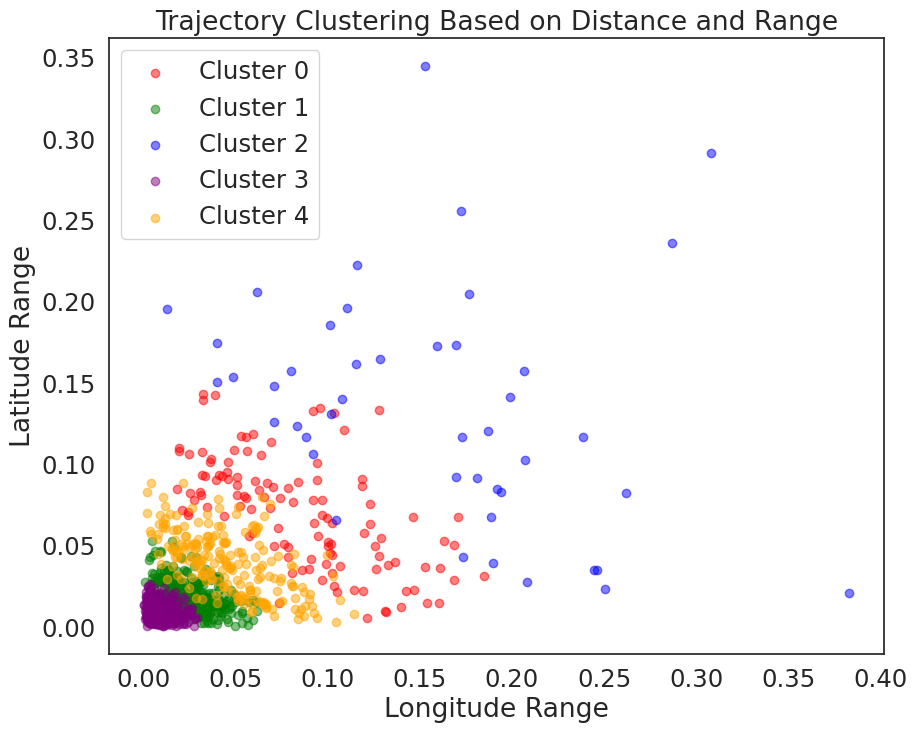

In [ ]:
from sklearn.cluster import MiniBatchKMeans
import matplotlib.pyplot as plt

# Assuming `trajs` is your trajectories dataset and `sample_size` is defined
sample_size = 1000 # adjust based on your computational capacity
sampled_trajs = random.sample(trajs, sample_size)

# Extract features for clustering
features = np.array([[compute_total_distance(traj), np.ptp(traj[:, 0]), np.ptp(traj[:, 1])] for traj in sampled_trajs])

# Use MiniBatchKMeans for scalable clustering
kmeans = MiniBatchKMeans(n_clusters=5, random_state=0, batch_size=10000)
kmeans.fit(features)
labels = kmeans.labels_

# Plotting the clusters
plt.figure(figsize=(10, 8))
colors = ['red', 'green', 'blue', 'purple', 'orange']
for i in range(5):
    mask = labels == i
    cluster = features[mask]
    plt.scatter(cluster[:, 1], cluster[:, 2], color=colors[i], label=f'Cluster {i}', alpha=0.5)

plt.xlabel('Longitude Range')
plt.ylabel('Latitude Range')
plt.title('Trajectory Clustering Based on Distance and Range')
plt.legend()
plt.show()


### Route prediction

In [ ]:
# Function to calculate Euclidean distance between two points
def calculate_distance(p1, p2):
    return np.sqrt((p1[0] - p2[0])**2 + (p1[1] - p2[1])**2)

# Function to find a route between two points
def find_route(trajectories, start_point, end_point, threshold=0.01):
    for traj in trajectories:
        if calculate_distance(traj[0], start_point) < threshold and calculate_distance(traj[-1], end_point) < threshold:
            return traj
    return None

start_index = random.randint(0, len(trajectories) - 1)
end_index = random.randint(0, len(trajectories) - 1)

# Get the first and last points of these trajectories
start_point = trajectories[start_index][0]
end_point = trajectories[end_index][-1]

# Find a route that starts near the start point and ends near the end point
route = find_route(trajectories, start_point, end_point)

if route is not None:
    # Initialize a Folium map at the starting point of the route
    m = folium.Map(location=[route[0][1], route[0][0]], zoom_start=12)

    # Add markers for the start and end points
    folium.Marker(
        location=[start_point[1], start_point[0]],
        popup=f'Start Point: Latitude {start_point[1]}, Longitude {start_point[0]}',
        icon=folium.Icon(color='green')
    ).add_to(m)

    folium.Marker(
        location=[end_point[1], end_point[0]],
        popup=f'End Point: Latitude {end_point[1]}, Longitude {end_point[0]}',
        icon=folium.Icon(color='red')
    ).add_to(m)

    # Add the route to the map
    folium_route = [(point[1], point[0]) for point in route]
    folium.PolyLine(locations=folium_route, weight=5, color='blue').add_to(m)

    # Display the map
    display(m)
else:
    print("No route found within the threshold distance.")
